<a href="https://colab.research.google.com/github/LeonardoMontella/NeuralNetworksProject-Music-Source-Separation/blob/main/Leonardo_Montella_Hybrid_Demucs_Music_Source_Separation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Hybrid Transformer For Music Separation

I installed the githup repository of demucs in order to obtain some usefull functions

In [ ]:
!python3 -m pip install -U git+https://github.com/facebookresearch/demucs --quiet

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.0/87.0 KB 1.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 446.3/446.3 KB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.6/41.6 KB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 KB 7.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.6/189.6 KB 20.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 KB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.1/73.1 KB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 KB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 KB 14.0 MB/s eta 0:00:00
  Preparing metadat

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


### DATASET MUSDB18



Musdb18 is a collection of 3500 songs from 200 various musical artists. The songs have been separated into their individual musical components, or "stems," by the producer. Each stem is then labeled with one of four sources based on the producer's naming conventions, such as "vocals2," "fx," "sub," etc. However, this labeling process is not always accurate as the names given can be subjective and open to interpretation. 

So out of the 3500 tracks, creators verified the labeling for 150 of them and removed any stems that were unclear. Later on I trained Hybrid transformer demucs model only on this 150 and I obtained really good results. To prepare the data, creators only kept stems where all four sources were audible for at least 30% of the time and defined silence as audio segments with volume below -40dB. 

Thanks to this dataset I was able to evaluate the model with SDR (more details later) because with this metric we can compare original source signals and the separated signals.

In [ ]:
!pip install nussl --quiet
!pip install git+https://github.com/source-separation/tutorial --quiet

I used nussl which is a smaller version of musdb in order to show the specs on colab


In [ ]:
import nussl
from IPython.display import Audio
import IPython


The following cell will download 7-second clips for 143 of the 150 tracks in the dataset (the remaining 7 tracks do not have preview clips due to copyright, but are included in the full dataset):

In [ ]:
musdb = nussl.datasets.MUSDB18(download=True)

Done!


94 songs for training

In [ ]:
musdb_train = nussl.datasets.MUSDB18(subsets=['train'])
print(musdb_train.items)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93]


50 songs for test

In [ ]:
musdb_test = nussl.datasets.MUSDB18(subsets=['test'])
print(musdb_test.items)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]


In [ ]:
idx = 0
item = musdb_train[idx]
item.keys()

dict_keys(['mix', 'sources', 'metadata'])

Labels are divided in Bass, Drums, Other and Vocals.

In [ ]:
item['metadata']

{'labels': ['bass', 'drums', 'other', 'vocals']}

In [ ]:
item['sources'].keys()

dict_keys(['drums', 'bass', 'other', 'vocals'])

Here is an example of non separated source:

In [ ]:
Audio(data=item['mix'].audio_data, rate=item['mix'].sample_rate)

Separated sources:

In [ ]:
for stem_label in item['sources'].keys():
    print(stem_label)
    audio_player = Audio(data=item['sources'][stem_label].audio_data, rate=item['sources'][stem_label].sample_rate)
    IPython.display.display(audio_player)

drums


bass


other


vocals


## INITIALIZATION


In [ ]:
extensions = ["mp3", "wav", "ogg", "flac"]  
two_stems = None   
# two_stems = "vocals"

# Output audio.
mp3 = True
mp3_rate = 320
float32 = False  # output as float 32 wavs, unsused if 'mp3' is True.
int24 = False    # output as int24 wavs, unused if 'mp3' is True.

#Here I generated two folders on my Google Drive: in 'demucs' I put the input song 
#and in 'demucs_separated' I will store all the outputs

in_path = '/gdrive/MyDrive/demucs/'
out_path = '/gdrive/MyDrive/demucs_separated/'

In [ ]:
import io
from pathlib import Path
import select
from shutil import rmtree
import subprocess as sp
import sys
from typing import Dict, Tuple, Optional, IO

from google.colab import files

### Initialize Files

This function takes all the files in the folder i selected in my drive

In [ ]:
def find_files(in_path):
    # Create an empty list to store the matching files
    out = []
    
    # Iterate over all the files in the directory specified by in_path
    for file in Path(in_path).iterdir():
        
        # Check if the file extension (without the dot) is in the list of desired extensions
        if file.suffix.lower().lstrip(".") in extensions:
            
            # If the extension is in the desired list, add the file to the output list
            out.append(file)
            
            #print(file)
    
    # Return the list of matching files
    return out
    
    #print(out)



Function to get the raw stream object from the passed stream, if the passed stream is a buffered stream.

In [ ]:
def copy_process_streams(process: sp.Popen):
    def raw(stream: Optional[IO[bytes]]) -> IO[bytes]:
        # Ensure that the passed stream is not None
        assert stream is not None
        
        # If the passed stream is a buffered stream, get the raw stream.
        if isinstance(stream, io.BufferedIOBase):
            stream = stream.raw
        
        # Return the raw stream.
        return stream

    # Get the raw stdout and stderr streams of the process.
    p_stdout, p_stderr = raw(process.stdout), raw(process.stderr)
    
    # Create a dictionary that maps file descriptors to their respective streams, 
    # standard streams, and string buffer stream objects.
    stream_by_fd: Dict[int, Tuple[IO[bytes], io.StringIO, IO[str]]] = {
        p_stdout.fileno(): (p_stdout, sys.stdout),
        p_stderr.fileno(): (p_stderr, sys.stderr),
    }
    
    # Get the list of file descriptors.
    fds = list(stream_by_fd.keys())
    
    # Continue the loop as long as there are file descriptors in the list.
    while fds:
        # Use the select function to wait until one of the file descriptors 
        # has content to be read.
        ready, _, _ = select.select(fds, [], [])
        
        # Loop over the file descriptors that have content.
        for fd in ready:
            # Get the process stream, standard stream, and string buffer stream objects 
            # corresponding to the file descriptor.
            p_stream, std = stream_by_fd[fd]
            
            # Read the contents of the process stream.
            raw_buf = p_stream.read(2 ** 16)
            
            # If the buffer is empty, remove the file descriptor from the list.
            if not raw_buf:
                fds.remove(fd)
                continue
            
            # Decode the contents of the buffer.
            buf = raw_buf.decode()
            
            # Write the decoded contents to the standard stream and string buffer stream.
            std.write(buf)
            std.flush()


### Spectograms


In [ ]:
import os
import glob
import imageio
import random, shutil
import torch
import torch.nn as nn
from tqdm.notebook import tqdm
import torch.nn.functional as F
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as display
import librosa
import librosa.display

In [ ]:
listname = os.listdir(path = in_path)
song_name = listname.pop()

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


y: [-2.4729091e-10  3.9534839e-10 -5.6605554e-10 ... -1.7050940e-01
 -2.3045276e-01  0.0000000e+00] 

y shape: (604104,) 

Sample rate (KHz): 22050 

Length of audio: 27.397006802721087


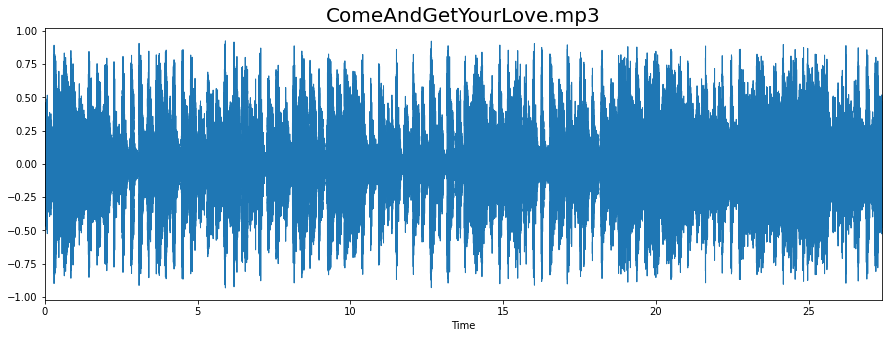

In [ ]:
y, sample_rate = librosa.load(in_path + '/' + song_name)

print('y:', y, '\n')
print('y shape:', np.shape(y), '\n')
print('Sample rate (KHz):', sample_rate, '\n')
print(f'Length of audio: {np.shape(y)[0]/sample_rate}')

# Plot th sound wave.

plt.figure(figsize=(15, 5))
librosa.display.waveplot(y=y, sr=sample_rate);
plt.title(song_name, fontsize=20)
plt.show()

In [ ]:
display.Audio(in_path + '/' + song_name)

Later on I will make some considerations about the spectograms (when I will analyze the separated parts spectograms).

Shape of D object: (1025, 1180)


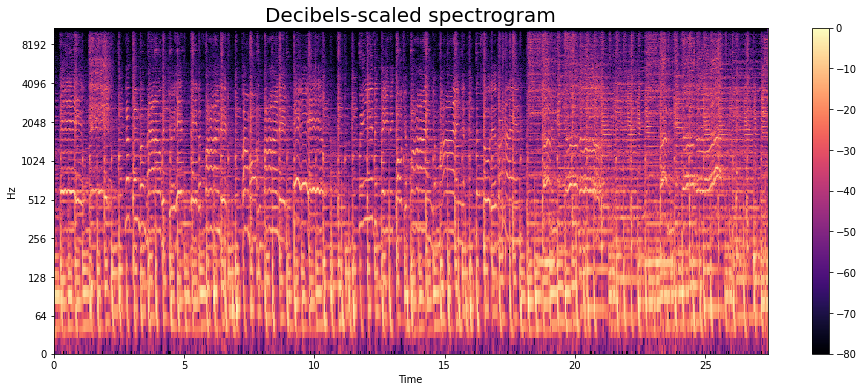

In [ ]:
# Convert sound wave to spectrogram.

# Short-time Fourier transform (STFT).

D = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
print('Shape of D object:', np.shape(D))

# Convert amplitude spectrogram to Decibels-scaled spectrogram.

DB = librosa.amplitude_to_db(D, ref = np.max)

# Creating the spectogram.

plt.figure(figsize = (16, 6))
librosa.display.specshow(DB, sr=sample_rate, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title('Decibels-scaled spectrogram', fontsize=20)
plt.show()

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


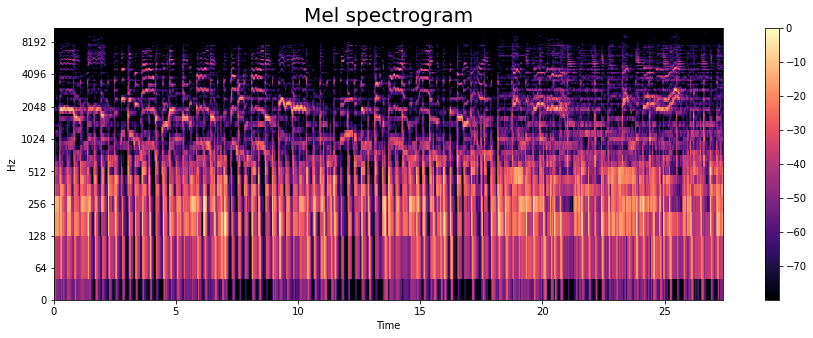

In [ ]:
# Convert sound wave to mel spectrogram.

y, sr = librosa.load(in_path + "/" + song_name)

S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(15, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title("Mel spectrogram", fontsize=20)
plt.show()

## MODEL Hybrid Transformer Demucs

The Hybrid Transformer Demucs Model is a neural network architecture for source separation. It combines two popular neural network models, the Transformer and the Convolutional Neural Network (CNN).
The architecture first uses a CNN to extract features from the mixed audio signal, and then uses the Transformer to process the extracted features and separate the individual sources. The Transformer part of the architecture uses self-attention mechanisms to model the relationships between different parts of the audio signal, and the CNN part uses convolutional filters to capture local patterns in the audio. This combination of the two models allows the Hybrid Transformer Demucs Model to handle both local and global dependencies in the audio, leading to improved source separation performance.

The original model is made up of two parts, one that operates on time data and the other on spectrogram data. Each part is made of 5 encoding layers and 5 decoding layers. The two parts come together after the 5th encoding layer and share a 6th layer. The first decoding layer is also shared, and its output is sent to both parts. The part that operates on spectrogram data is transformed back into sound and combined with the other part to produce the final output of the model.

The Hybrid Transformer Demucs model has a different design than the original one because it uses a new type of layer called the cross-domain Transformer Encoder. The outermost 4 layers of the model were kept the same, but the two innermost layers were changed. The new model can work with different shapes of data, making it more flexible. It uses attention to process the data in parallel, and normalizes the data before processing it. It also uses techniques like sinusoidal encodings to help with processing the data. 

<img src='https://github.com/facebookresearch/demucs/blob/main/demucs.png?raw=true' width= '570' height='550'>

###MODEL

I took as a reference the Hybrid Demucs Model in order to insert all the hyperparameters I needed.


In [38]:
import math
from demucs import hdemucs
from openunmix.filtering import wiener
import torch
from torch import nn
from torch.nn import functional as F
from fractions import Fraction
from einops import rearrange

from demucs.transformer import CrossTransformerEncoder

from demucs.demucs import rescale_module
from demucs.states import capture_init
from demucs.spec import spectro, ispectro
from demucs.hdemucs import pad1d, ScaledEmbedding, HEncLayer, MultiWrap, HDecLayer



class LeoNet(nn.Module):

    def __init__(
        self,
        sources,
        # Channels
        audio_channels=2,
        channels=48,
        channels_time=None,
        growth=2,
        # STFT
        nfft=4096,
        wiener_iters=0,
        end_iters=0,
        wiener_residual=False,
        cac=True,
        # Main structure
        depth=4,
        rewrite=True,
        # Frequency branch
        multi_freqs=None,
        multi_freqs_depth=3,
        freq_emb=0.2,
        emb_scale=10,
        emb_smooth=True,
        # Convolutions
        kernel_size=8,
        time_stride=2,
        stride=4,
        context=1,
        context_enc=0,
        # Normalization
        norm_starts=4,
        norm_groups=4,
        # DConv residual branch
        dconv_mode=1,
        dconv_depth=2,
        dconv_comp=8,
        dconv_init=1e-3,
        # Before the Transformer
        bottom_channels=0,
        # Transformer
        t_layers=5,
        t_emb="sin",
        t_hidden_scale=4.0,
        t_heads=8,
        t_dropout=0.0,
        t_max_positions=10000,
        t_norm_in=True,
        t_norm_in_group=False,
        t_group_norm=False,
        t_norm_first=True,
        t_norm_out=True,
        t_max_period=10000.0,
        t_weight_decay=0.0,
        t_lr=None,
        t_layer_scale=True,
        t_gelu=True,
        t_weight_pos_embed=1.0,
        t_sin_random_shift=0,
        t_cape_mean_normalize=True,
        t_cape_augment=True,
        t_cape_glob_loc_scale=[5000.0, 1.0, 1.4],
        t_sparse_self_attn=False,
        t_sparse_cross_attn=False,
        t_mask_type="diag",
        t_mask_random_seed=42,
        t_sparse_attn_window=500,
        t_global_window=100,
        t_sparsity=0.95,
        t_auto_sparsity=False,
        # ------ Particuliar parameters
        t_cross_first=False,
        # Weight init
        rescale=0.1,
        # Metadata
        samplerate=44100,
        segment=10,
        use_train_segment=True,
    ):
        
        super().__init__()
        self.cac = cac
        self.wiener_residual = wiener_residual
        self.audio_channels = audio_channels
        self.sources = sources
        self.kernel_size = kernel_size
        self.context = context
        self.stride = stride
        self.depth = depth
        self.bottom_channels = bottom_channels
        self.channels = channels
        self.samplerate = samplerate
        self.segment = segment
        self.use_train_segment = use_train_segment
        self.nfft = nfft
        self.hop_length = nfft // 4
        self.wiener_iters = wiener_iters
        self.end_iters = end_iters
        self.freq_emb = None
        assert wiener_iters == end_iters

        self.encoder = nn.ModuleList()
        self.decoder = nn.ModuleList()

        self.tencoder = nn.ModuleList()
        self.tdecoder = nn.ModuleList()

        chin = audio_channels
        chin_z = chin  # number of channels for the freq branch
        if self.cac:
            chin_z *= 2
        chout = channels_time or channels
        chout_z = channels
        freqs = nfft // 2

        for index in range(depth):
            norm = index >= norm_starts
            freq = freqs > 1
            stri = stride
            ker = kernel_size
            if not freq:
                assert freqs == 1
                ker = time_stride * 2
                stri = time_stride

            pad = True
            last_freq = False
            if freq and freqs <= kernel_size:
                ker = freqs
                pad = False
                last_freq = True

            kw = {
                "kernel_size": ker,
                "stride": stri,
                "freq": freq,
                "pad": pad,
                "norm": norm,
                "rewrite": rewrite,
                "norm_groups": norm_groups,
                "dconv_kw": {
                    "depth": dconv_depth,
                    "compress": dconv_comp,
                    "init": dconv_init,
                    "gelu": True,
                },
            }
            kwt = dict(kw)
            kwt["freq"] = 0
            kwt["kernel_size"] = kernel_size
            kwt["stride"] = stride
            kwt["pad"] = True
            kw_dec = dict(kw)
            multi = False
            if multi_freqs and index < multi_freqs_depth:
                multi = True
                kw_dec["context_freq"] = False

            if last_freq:
                chout_z = max(chout, chout_z)
                chout = chout_z

            enc = HEncLayer(
                chin_z, chout_z, dconv=dconv_mode & 1, context=context_enc, **kw
            )
            if freq:
                tenc = HEncLayer(
                    chin,
                    chout,
                    dconv=dconv_mode & 1,
                    context=context_enc,
                    empty=last_freq,
                    **kwt
                )
                self.tencoder.append(tenc)

            if multi:
                enc = MultiWrap(enc, multi_freqs)
            self.encoder.append(enc)
            if index == 0:
                chin = self.audio_channels * len(self.sources)
                chin_z = chin
                if self.cac:
                    chin_z *= 2
            dec = HDecLayer(
                chout_z,
                chin_z,
                dconv=dconv_mode & 2,
                last=index == 0,
                context=context,
                **kw_dec
            )
            if multi:
                dec = MultiWrap(dec, multi_freqs)
            if freq:
                tdec = HDecLayer(
                    chout,
                    chin,
                    dconv=dconv_mode & 2,
                    empty=last_freq,
                    last=index == 0,
                    context=context,
                    **kwt
                )
                self.tdecoder.insert(0, tdec)
            self.decoder.insert(0, dec)

            chin = chout
            chin_z = chout_z
            chout = int(growth * chout)
            chout_z = int(growth * chout_z)
            if freq:
                if freqs <= kernel_size:
                    freqs = 1
                else:
                    freqs //= stride
            if index == 0 and freq_emb:
                self.freq_emb = ScaledEmbedding(
                    freqs, chin_z, smooth=emb_smooth, scale=emb_scale
                )
                self.freq_emb_scale = freq_emb

        if rescale:
            rescale_module(self, reference=rescale)

        transformer_channels = channels * growth ** (depth - 1)
        if bottom_channels:
            self.channel_upsampler = nn.Conv1d(transformer_channels, bottom_channels, 1)
            self.channel_downsampler = nn.Conv1d(
                bottom_channels, transformer_channels, 1
            )
            self.channel_upsampler_t = nn.Conv1d(
                transformer_channels, bottom_channels, 1
            )
            self.channel_downsampler_t = nn.Conv1d(
                bottom_channels, transformer_channels, 1
            )

            transformer_channels = bottom_channels

        if t_layers > 0:
            self.crosstransformer = CrossTransformerEncoder(
                dim=transformer_channels,
                emb=t_emb,
                hidden_scale=t_hidden_scale,
                num_heads=t_heads,
                num_layers=t_layers,
                cross_first=t_cross_first,
                dropout=t_dropout,
                max_positions=t_max_positions,
                norm_in=t_norm_in,
                norm_in_group=t_norm_in_group,
                group_norm=t_group_norm,
                norm_first=t_norm_first,
                norm_out=t_norm_out,
                max_period=t_max_period,
                weight_decay=t_weight_decay,
                lr=t_lr,
                layer_scale=t_layer_scale,
                gelu=t_gelu,
                sin_random_shift=t_sin_random_shift,
                weight_pos_embed=t_weight_pos_embed,
                cape_mean_normalize=t_cape_mean_normalize,
                cape_augment=t_cape_augment,
                cape_glob_loc_scale=t_cape_glob_loc_scale,
                sparse_self_attn=t_sparse_self_attn,
                sparse_cross_attn=t_sparse_cross_attn,
                mask_type=t_mask_type,
                mask_random_seed=t_mask_random_seed,
                sparse_attn_window=t_sparse_attn_window,
                global_window=t_global_window,
                sparsity=t_sparsity,
                auto_sparsity=t_auto_sparsity,
            )
        else:
            self.crosstransformer = None

#THIS PART ABOVE IS INSPIRED BY DEMUCS            
######################################################################
#IN THIS PART I HAVE CREATED ALL THE NECESSARY FUNCTIONS

    def compute_spectrogram(self, x):
        """Compute the spectrogram of the input signal x."""
        hl = self.hop_length
        nfft = self.nfft
        x0 = x
        # Ensure the hop length is one-fourth of nfft
        assert hl == nfft // 4
        # Calculate the number of frames in x
        num_frames = int(math.ceil(x.shape[-1] / hl))
        # Pad x with reflected values to make it a multiple of hl
        padding = hl // 2 * 3
        x = pad1d(x, (padding, padding + num_frames * hl - x.shape[-1]), mode="reflect")
        # Compute the spectrogram of the padded signal
        spectrogram = spectro(x, nfft, hl)[..., :-1, :]
        # Ensure the spectrogram has the expected shape
        assert spectrogram.shape[-1] == num_frames + 4, (spectrogram.shape, x.shape, num_frames)
        # Trim the spectrogram to only include the desired frames
        spectrogram = spectrogram[..., 2: 2 + num_frames]
        return spectrogram


    def _ispec(self, z, length=None, scale=0):
        """
        This function computes the inverse spectrogram of the input signal `z`.
        """
        # Store the hop length, adjusted based on the scale factor
        hl = self.hop_length // (4**scale)      
        # Pad the input signal in two steps
        z = F.pad(z, (0, 0, 0, 1))
        z = F.pad(z, (2, 2))      
        # Calculate the amount of padding
        padding = hl // 2 * 3      
        # Calculate the length of the inverse spectrogram
        computed_length = hl * int(math.ceil(length / hl)) + 2 * padding      
        # Compute the inverse spectrogram
        x = ispectro(z, hl, length=computed_length)    
        # Trim the computed signal to the desired length
        x = x[..., padding: padding + length]     
        # Return the computed inverse spectrogram
        return x


    def _magnitude(self, z):
        # Calculate the magnitude of the input spectrogram `z`.
        # If `cac` (CAC: Complex-valued Activation Functions) is set to True,
        # the complex dimension is moved to the channel dimension.
        # Otherwise, the magnitude is calculated using `abs()` function.
        # Returns: The calculated magnitude.

        if self.cac:
            # Get the shape of the input spectrogram.
            B, C, Fr, T = z.shape            
            # Move the complex dimension to channel dimension.
            m = torch.view_as_real(z).permute(0, 1, 4, 2, 3)            
            # Reshape the magnitude to have the desired shape.
            m = m.reshape(B, C * 2, Fr, T)
        else:
            # Calculate the magnitude using `abs()` function.
            m = z.abs()
            
        return m


    def _mask(self, z, m):
        # Apply the masking to the mixture spectrogram `z` given the estimated mask `m`.
        # If `cac` is set to True, `m` is actually a full spectrogram and `z` is ignored.
        # Returns: The masked spectrogram.
        
        # Store the number of iterations for Wiener filtering.
        num_wiener_iterations = self.wiener_iters        
        if self.cac:
            # Get the shape of the full spectrogram.
            batch_size, num_sources, channels, frequency_bins, time_steps = m.shape            
            # Reshape and permute the spectrogram.
            reshaped_permuted_spectrogram = m.view(batch_size, num_sources, -1, 2, frequency_bins, time_steps).permute(0, 1, 2, 4, 5, 3)            
            # Convert the reshaped and permuted spectrogram back to a complex-valued tensor.
            masked_spectrogram = torch.view_as_complex(reshaped_permuted_spectrogram.contiguous())
            return masked_spectrogram
        
        # If the model is in training mode, use `end_iters` instead of `wiener_iters`.
        if self.training:
            num_wiener_iterations = self.end_iters
        
        if num_wiener_iterations < 0:
            # If the number of iterations is negative, apply element-wise division and element-wise multiplication.
            z = z[:, None]
            masked_spectrogram = z / (1e-8 + z.abs()) * m
        else:
            # Otherwise, apply the Wiener filter using the `_wiener` method.
            masked_spectrogram = self._wiener(m, z, num_wiener_iterations)
            
        return masked_spectrogram


    def _wiener(self, mag_out, mix_stft, niters):
        """
        Apply Wiener filtering from OpenUnmix.

        Returns:
        - torch.Tensor: filtered spectrogram

        """
        # Initial data type
        init = mix_stft.dtype
        # Length of the window for Wiener filtering
        wiener_win_len = 300
        # Wiener residual flag
        residual = self.wiener_residual
        # Shape of the output magnitude spectrogram
        B, S, C, Fq, T = mag_out.shape
        # Permute the dimensions for easier processing
        mag_out = mag_out.permute(0, 4, 3, 2, 1)
        mix_stft = torch.view_as_real(mix_stft.permute(0, 3, 2, 1))
        # List to store the filtered spectrogram for each sample
        outs = []
        for sample in range(B):
            # Start position for the frame
            pos = 0
            out = []
            for pos in range(0, T, wiener_win_len):
                # Get the current frame
                frame = slice(pos, pos + wiener_win_len)
                # Apply Wiener filtering on the current frame
                z_out = wiener(
                    mag_out[sample, frame],
                    mix_stft[sample, frame],
                    niters,
                    residual=residual,
                )
                # Add the filtered frame to the output list
                out.append(z_out.transpose(-1, -2))
            # Concatenate the filtered frames for the current sample
            outs.append(torch.cat(out, dim=0))
        # Stack the filtered spectrograms for all samples
        out = torch.view_as_complex(torch.stack(outs, 0))
        # Permute the dimensions back to the original form
        out = out.permute(0, 4, 3, 2, 1).contiguous()
        # Remove the last axis if the residual flag is set
        if residual:
            out = out[:, :-1]
        # Ensure the final shape is correct
        assert list(out.shape) == [B, S, C, Fq, T]
        # Return the filtered spectrogram with the original data type
        return out.to(init)



    def valid_length(self, length: int):
        """
        Return a length that is appropriate for evaluation.
        
        """
        if not self.use_train_segment:
            return length
        training_length = int(self.segment * self.samplerate)
        if training_length < length:
            raise ValueError(
                    f"Given length {length} is longer than "
                    f"training length {training_length}")
        return training_length

        #The method first checks the value of the attribute use_train_segment. 
        #If use_train_segment is False, then length is returned as-is. If use_train_segment is True, 
        #then the method calculates the training_length as the product of the segment attribute and samplerate attribute, 
        #both of which are class attributes. If training_length is less than length, then a ValueError is raised 
        #with an error message that indicates that the given length is longer than the training length. Otherwise, 
        #training_length is returned as the appropriate length for evaluation."""

    def forward(self, mix):
        length = mix.shape[-1]
        length_pre_pad = None
        if self.use_train_segment:
            if self.training:
                self.segment = Fraction(mix.shape[-1], self.samplerate)
            else:
                training_length = int(self.segment * self.samplerate)
                if mix.shape[-1] < training_length:
                    length_pre_pad = mix.shape[-1]
                    mix = F.pad(mix, (0, training_length - length_pre_pad))
        z = self._spec(mix)
        mag = self._magnitude(z)
        x = mag

        B, C, Fq, T = x.shape

       
        mean = x.mean(dim=(1, 2, 3), keepdim=True)
        std = x.std(dim=(1, 2, 3), keepdim=True)
        x = (x - mean) / (1e-5 + std)
        # x will be the freq. branch input.

        # Prepare the time branch input.
        xt = mix
        meant = xt.mean(dim=(1, 2), keepdim=True)
        stdt = xt.std(dim=(1, 2), keepdim=True)
        xt = (xt - meant) / (1e-5 + stdt)

        
        saved = []  # skip connections, freq.
        saved_t = []  # skip connections, time.
        lengths = []  # saved lengths to properly remove padding, freq branch.
        lengths_t = []  # saved lengths for time branch.
        for idx, encode in enumerate(self.encoder):
            lengths.append(x.shape[-1])
            inject = None
            if idx < len(self.tencoder):
                # we have not yet merged branches.
                lengths_t.append(xt.shape[-1])
                tenc = self.tencoder[idx]
                xt = tenc(xt)
                if not tenc.empty:
                    # save for skip connection
                    saved_t.append(xt)
                else:
                    # tenc contains just the first conv., so that now time and freq.
                    # branches have the same shape and can be merged.
                    inject = xt
            x = encode(x, inject)
            if idx == 0 and self.freq_emb is not None:
                # add frequency embedding to allow for non equivariant convolutions
                # over the frequency axis.
                frs = torch.arange(x.shape[-2], device=x.device)
                emb = self.freq_emb(frs).t()[None, :, :, None].expand_as(x)
                x = x + self.freq_emb_scale * emb

            saved.append(x)
        if self.crosstransformer:
            if self.bottom_channels:
                b, c, f, t = x.shape
                x = rearrange(x, "b c f t-> b c (f t)")
                x = self.channel_upsampler(x)
                x = rearrange(x, "b c (f t)-> b c f t", f=f)
                xt = self.channel_upsampler_t(xt)

            x, xt = self.crosstransformer(x, xt)

            if self.bottom_channels:
                x = rearrange(x, "b c f t-> b c (f t)")
                x = self.channel_downsampler(x)
                x = rearrange(x, "b c (f t)-> b c f t", f=f)
                xt = self.channel_downsampler_t(xt)

        for idx, decode in enumerate(self.decoder):
            skip = saved.pop(-1)
            x, pre = decode(x, skip, lengths.pop(-1))
            # `pre` contains the output just before final transposed convolution,
            # which is used when the freq. and time branch separate.

            offset = self.depth - len(self.tdecoder)
            if idx >= offset:
                tdec = self.tdecoder[idx - offset]
                length_t = lengths_t.pop(-1)
                if tdec.empty:
                    assert pre.shape[2] == 1, pre.shape
                    pre = pre[:, :, 0]
                    xt, _ = tdec(pre, None, length_t)
                else:
                    skip = saved_t.pop(-1)
                    xt, _ = tdec(xt, skip, length_t)

        # Let's make sure we used all stored skip connections.
        assert len(saved) == 0
        assert len(lengths_t) == 0
        assert len(saved_t) == 0

        S = len(self.sources)
        x = x.view(B, S, -1, Fq, T)
        x = x * std[:, None] + mean[:, None]

        zout = self._mask(z, x)
        if self.use_train_segment:
            if self.training:
                x = self._ispec(zout, length)
            else:
                x = self._ispec(zout, training_length)
        else:
            x = self._ispec(zout, length)

        if self.use_train_segment:
            if self.training:
                xt = xt.view(B, S, -1, length)
            else:
                xt = xt.view(B, S, -1, training_length)
        else:
            xt = xt.view(B, S, -1, length)
        xt = xt * stdt[:, None] + meant[:, None]
        x = xt + x
        if length_pre_pad:
            x = x[..., :length_pre_pad]
        return x

In [ ]:
SOURCES = ["drums", "bass", "other", "vocals"]
NN = LeoNet(sources=SOURCES)

In [ ]:
str(NN)

"LeoNet(\n  (encoder): ModuleList(\n    (0): HEncLayer(\n      (conv): Conv2d(4, 48, kernel_size=(8, 1), stride=(4, 1), padding=(2, 0))\n      (norm1): Identity()\n      (rewrite): Conv2d(48, 96, kernel_size=(1, 1), stride=(1, 1))\n      (norm2): Identity()\n      (dconv): DConv(\n        (layers): ModuleList(\n          (0): Sequential(\n            (0): Conv1d(48, 6, kernel_size=(3,), stride=(1,), padding=(1,))\n            (1): GroupNorm(1, 6, eps=1e-05, affine=True)\n            (2): GELU(approximate='none')\n            (3): Conv1d(6, 96, kernel_size=(1,), stride=(1,))\n            (4): GroupNorm(1, 96, eps=1e-05, affine=True)\n            (5): GLU(dim=1)\n            (6): LayerScale()\n          )\n          (1): Sequential(\n            (0): Conv1d(48, 6, kernel_size=(3,), stride=(1,), padding=(2,), dilation=(2,))\n            (1): GroupNorm(1, 6, eps=1e-05, affine=True)\n            (2): GELU(approximate='none')\n            (3): Conv1d(6, 96, kernel_size=(1,), stride=(1,))\n  

### MODEL EVALUATION


The Hybrid Transformer Demucs model is evaluated using the Scale-Invariant Signal-to-Distortion Ratio (SDR) metric. The SDR metric measures the quality of the audio separation produced by the model, and it is calculated as the difference between the signal power and the distortion power.
In the case of Hybrid Transformer Demucs, the input audio mixture is separated into different sources, and the SDR value is calculated for each source. The higher the SDR value, the better the quality of the separation.
SDR is a commonly used evaluation metric in the field of audio signal processing, and it is a good indicator of how well the Hybrid Transformer Demucs model is able to separate audio sources in a mixture.

<img src='https://d3i71xaburhd42.cloudfront.net/826dad99e9725d46c15083a750f9a36e8d6861d5/2-Table1-1.png'>


I personally used the pretrained HTDemucs with 150 songs of the musdb18 dataset. It has good values of SDR considering that, for a music source audio, they generally range around 10db. So for bass and drums we got excellent results (respectivetly 9.76 db and 9.51 db). However, it is important to note that there is no absolute threshold for a "good" SDR value, as the acceptable value can depend on the specific requirements and constraints of each individual application.

Speaking on training, the only way to do it is locally with a dataset of over 20GB so the time is really too long.

In order to make training more fast, creators suggest to use Dora: it is a library for Python that can be used to train a model and perform hyperparameter tuning. Dora allows you to specify the hyperparameters you want to tune and the search space for each hyperparameter. Then, it automatically trains your model with different combinations of hyperparameters and selects the best combination based on a performance metric that you specify. This saves you the time and effort of manually tuning the hyperparameters, and helps you find the best hyperparameters for your model more efficiently.

Dora assign at each hyper parameters group or experiment of a model a signature. To use this signature in Dora, you can specify a name for your experiment and define the hyperparameters or settings you want to experiment with. Dora will then automatically generate a unique signature for each run of the experiment, based on the name and hyperparameters you specified. This allows you to keep track of the results of each run, and easily compare the performance of different runs. 



These are the main commands for training a model with dora

In [ ]:
!pip install dora --quiet

This has to be done locally (81de367c is an example).

In [ ]:
!dora info -f 81de367c  # this will show the hyper-parameter used by a specific XP.
                       # Be careful some overrides might present twice, and the right most one
                       # will give you the right value for it.
!dora run -d -f 81de367c   # run an XP with the hyper-parameters from XP 81de367c.
                          # `-d` is for distributed, it will use all available GPUs.
!dora run -d -f 81de367c hdemucs.channels=32  # start from the config of XP 81de367c but change some hyper-params.
                                             # This will give you a new XP with a new signature (here 3fe9c332)


#If you want to create a new variant combining multiple 
#hyper-params, copy the file conf/variant/example.yaml (git hub repo of Demucs)
#to conf/variant/my_variant.yaml, and then you can use it with

!dora run -d variant=my_variant

In [ ]:
#If a first model is trained, you can fine tune it with other settings
!dora run -d -f 81de367c continue_from=81de367c dset=auto_mus variant=finetune

In order to use the model with demucs function like the separation one, we have to export our model in this way:

In [ ]:
!python3 -m tools.export 9357e12e [OTHER SIGS ...] 

#and then it will be stored in release_models so as we can use it with functions
!demucs --repo ./release_models -n 9357e12e my_track.mp3

Finally we can evaluate the model automatically with the new SDR definition from MDX every 20 epochs with this command:

In [ ]:
%cd /gdrive/MyDrive/demucs-main/tools
!ls

/gdrive/MyDrive/demucs-main/tools
automix.py  convert.py	__init__.py  test_pretrained.py
bench.py    export.py	__pycache__


In [ ]:
!python3 -m ./tools.test_pretrained -n htdemucs

## SEPARATION

In this section I reported two types of separation function: the first one is simply a function that call the demcus separate function and stores the outputs directly on my google drive; the second one is my personal recreation of the separation function using the torchaudio HDEMUCS_HIGH_MUSDB_PLUS bundle. 

### Separate File saved on Drive

In [ ]:
def separate(inp=None, outp=None):
    # Use the input path specified, or use the default input path
    inp = inp or in_path
    # Use the output path specified, or use the default output path
    outp = outp or out_path
    
    # Create the command to run the separation script
    cmd = ["python3", "-m", "demucs.separate", "-o", str(outp), "-n", "htdemucs"]

    # Add optional arguments to the command
    if mp3:
        cmd += ["--mp3", f"--mp3-bitrate={mp3_rate}"]
    if float32:
        cmd += ["--float32"]
    if int24:
        cmd += ["--int24"]
    if two_stems is not None:
        cmd += [f"--two-stems={two_stems}"]
    
    # Find the audio files in the input directory and convert to strings
    files = [str(f) for f in find_files(inp)]
    # If there are no valid audio files, print a message and return
    if not files:
        print(f"No valid audio files in {in_path}")
        return

    # Print the list of files to be separated and the command used
    print("Going to separate the files:")
    print('\n'.join(files))
    print("With command: ", " ".join(cmd))

    # Run the separation script and pipe the output to the console
    p = sp.Popen(cmd + files, stdout=sp.PIPE, stderr=sp.PIPE)
    copy_process_streams(p)
    p.wait()
    
    # Check the return code of the script, and print an error message if necessary
    if p.returncode != 0:
        print("Command failed, something went wrong.")



In [ ]:
separate()

Going to separate the files:
/gdrive/MyDrive/demucs/ComeAndGetYourLove.mp3
With command:  python3 -m demucs.separate -o /gdrive/MyDrive/demucs_separated/ -n htdemucs --mp3 --mp3-bitrate=320


Downloading: "https://dl.fbaipublicfiles.com/demucs/hybrid_transformer/955717e8-8726e21a.th" to /root/.cache/torch/hub/checkpoints/955717e8-8726e21a.th
100%|██████████| 80.2M/80.2M [00:06<00:00, 14.0MB/s]

Selected model is a bag of 1 models. You will see that many progress bars per track.
Separated tracks will be stored in /gdrive/MyDrive/demucs_separated/htdemucs
Separating track /gdrive/MyDrive/demucs/ComeAndGetYourLove.mp3



100%|████████████████████████████████████████████████████████████████████████| 29.25/29.25 [00:07<00:00,  3.93seconds/s]


### MY Separation function 

In [ ]:
import torch
import torchaudio

print(torch.__version__)
print(torchaudio.__version__)

1.13.1+cu116
0.13.1+cu116


In [ ]:
!pip install mir_eval --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.7/90.7 KB 9.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
from IPython.display import Audio
from torchaudio.utils import download_asset
import matplotlib.pyplot as plt

try:
    from torchaudio.pipelines import HDEMUCS_HIGH_MUSDB_PLUS
    from mir_eval import separation

except ModuleNotFoundError:
    try:
        import google.colab

        
    except ModuleNotFoundError:
        pass
    raise

In this bundle I used htdemucs_high() model which is suitable for sample rates of 44.1-48 kHz which is the perfect range for songs. As before it will separate the track in the four sources. 

In [ ]:
# Import the high-quality HDEMUCS model with the MUSDB dataset
bundle = HDEMUCS_HIGH_MUSDB_PLUS

# Define the sources to separate
SOURCES = ["drums","bass","other", "vocals"]

# Get the separation model
model = bundle.get_model()

# Determine if CUDA is available, and set the device accordingly
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Move the model to the selected device
model.to(device)

# Get the sample rate of the audio used in the bundle
sample_rate = bundle.sample_rate

# Print information about the bundle and sample rate
print(bundle)
print(f"Sample rate: {sample_rate}")


  0%|          | 0.00/319M [00:00<?, ?B/s]

SourceSeparationBundle(_model_path='models/hdemucs_high_trained.pt', _model_factory_func=functools.partial(<function hdemucs_high at 0x7f5e46c92af0>, sources=['drums', 'bass', 'other', 'vocals']), _sample_rate=44100)
Sample rate: 44100


In [ ]:
from torchaudio.transforms import Fade

def plot_spectrogram(stft, title="Spectrogram"):
    magnitude = stft.abs()
    spectrogram = 20 * torch.log10(magnitude + 1e-8).numpy()
    figure, axis = plt.subplots(1, 1)
    img = axis.imshow(spectrogram, cmap="viridis", vmin=-60, vmax=0, origin="lower", aspect="auto")
    figure.suptitle(title)
    plt.colorbar(img, ax=axis)
    plt.show()

My separate_sources function takes as input the mixed audio signal, the model that will be used to separate the sources, and parameters such as the segment size and overlap between segments. The function is processed in chunks of audio, and the separated sources are accumulated in a final output tensor. 

Chunks of audio refers to a segment of audio that is divided into smaller parts. In the function the mixed audio is divided into chunks of specific length (calculated as "chunk_len") and each chunk is then processed independently. This is done so that large audio files can be processed in smaller parts and processed efficiently. 

A fade transform is applied to the output from the model to avoid abrupt changes between chunks. The final output tensor has the same number of audio channels as the input mixed audio, but the number of sources that are separated can be different. The function returns the final output tensor, which contains the separated audio sources.

In [ ]:
def separate_sources(model, mix, segment=10., overlap=0.1, device=None):
    
    from torchaudio.transforms import Fade

    # Determine the device to use
    if not device:
        device = mix.device
    else:
        device = torch.device(device)

    # Get the shape of the input mix
    batch, channels, audio_length = mix.shape

    # Calculate the length of each chunk
    chunk_len = int(sample_rate * segment * (1 + overlap))
    chunk_start = 0
    chunk_end = chunk_len

    # Calculate the number of overlapping frames between chunks
    overlap_frames = int(overlap * sample_rate)

    # Initialize the fade transform
    fade = Fade(fade_in_len=0, fade_out_len=overlap_frames, fade_shape='linear')

    # Initialize the final output tensor
    final_output = torch.zeros(batch, len(model.sources), channels, audio_length, device=device)

    # Process each chunk of the mixed audio
    while chunk_start < audio_length - overlap_frames:
        chunk = mix[:, :, chunk_start:chunk_end]

        # Forward the chunk through the model
        with torch.no_grad():
            output = model(chunk)

        # Apply the fade transform
        output = fade(output)

        # Add the separated sources to the final output
        final_output[:, :, :, chunk_start:chunk_end] += output

        # Update the fade transform parameters
        if chunk_start == 0:
            fade.fade_in_len = overlap_frames
            chunk_start += chunk_len - overlap_frames
        else:
            chunk_start += chunk_len
        chunk_end += chunk_len
        if chunk_end >= audio_length:
            fade.fade_out_len = 0

    return final_output


In [ ]:
SAMPLE_SONG = download_asset("/gdrive/MyDrive/demucs/" + song_name)
waveform, sample_rate = torchaudio.load(SAMPLE_SONG)  
waveform = waveform.to(device)
mixture = waveform

# parameters
segment: int = 10
overlap = 0.1

print("Separating track")

ref = waveform.mean(0)
waveform = (waveform - ref.mean()) / ref.std()  # normalization

sources = separate_sources(
    model,
    waveform[None],
    device=device,
    segment=segment,
    overlap=overlap,
)[0]
sources = sources * ref.std() + ref.mean()

sources_list = model.sources
sources = list(sources)

audios = dict(zip(sources_list, sources))

Separating track


The final output of the function is a tensor of shape (batch, len(model.sources), channels, audio_length), where batch is the number of mixed audio examples, len(model.sources) is the number of sources being separated, channels is the number of audio channels in the mixed audio, and audio_length is the length of the mixed audio. The tensor contains the separated sources for each mixed audio example in the batch.

In [ ]:
audios["drums"]

tensor([[-0.0077, -0.0104, -0.0079,  ..., -0.0155, -0.0207, -0.0032],
        [-0.0012, -0.0038, -0.0037,  ..., -0.0101, -0.0147, -0.0286]],
       device='cuda:0')

## Separated Audio

In [ ]:
display.Audio(audios["drums"].cpu(), rate=sample_rate)

In [ ]:
display.Audio(audios["bass"].cpu(), rate=sample_rate)

In [ ]:
display.Audio(audios["other"].cpu(), rate=sample_rate)

In [ ]:
display.Audio(audios["vocals"].cpu(), rate=sample_rate)

## Separated Spectograms


In [ ]:

s_path = ('/gdrive/MyDrive/demucs_separated/htdemucs/' + song_name + '/')
name = Path(s_path).stem
sep_path = ('/gdrive/MyDrive/demucs_separated/htdemucs/' + name + '/')

A spectrogram is a graphical representation of the frequency content of a signal, typically an audio signal, over time. The spectrogram is created by dividing the audio signal into overlapping segments, transforming each segment into the frequency domain using a Fourier transform, and then plotting the magnitude of the resulting frequency content as a function of time and frequency.

The vertical axis represents frequency, with low frequencies near the bottom and high frequencies near the top. The horizontal axis represents time.

The intensity of the color or shading in this spectograms indicates the magnitude of the frequency content at each point in time and frequency. Bright colors indicate high magnitudes, while darker colors indicate lower magnitudes.

I also decided to plot the MEL spectogram of each audio file: this is a type of spectrogram that is specifically designed to represent the characteristics of human auditory perception. It is based on a logarithmic scale used to measure the perceived pitch of a sound. 

The reason I decided to plot this type of spectogram is because, compared to a regular spectrogram, the mel spectrogram emphasizes the frequencies that are more important for human perception and de-emphasizes frequencies that are less important. This makes it a more suitable representation for this kind of task, where human perception is a crucial factor.

### DRUMS SPECT

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Shape of D object: (1025, 1182)


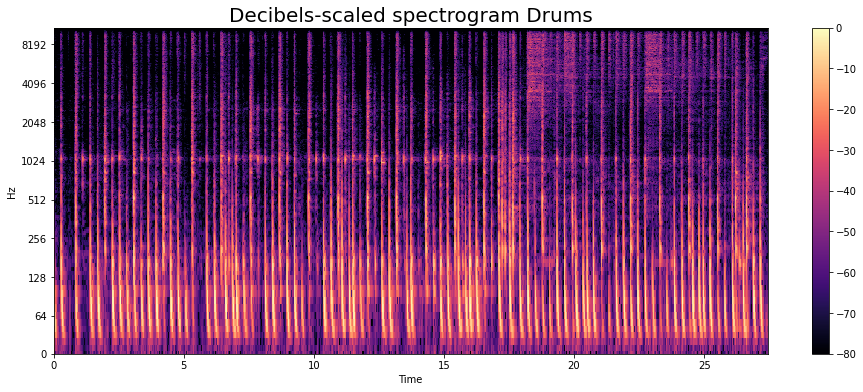

In [ ]:
y, sample_rate = librosa.load(sep_path + 'drums.mp3')
D = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
print('Shape of D object:', np.shape(D))



DB = librosa.amplitude_to_db(D, ref = np.max)



plt.figure(figsize = (16, 6))
librosa.display.specshow(DB, sr=sample_rate, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title('Decibels-scaled spectrogram Drums', fontsize=20)
plt.show()

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


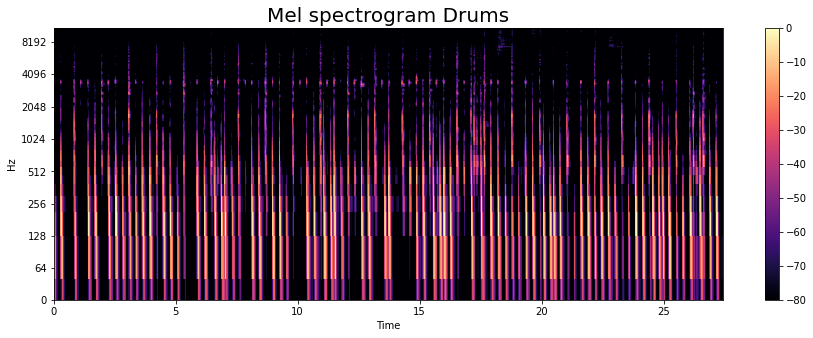

In [ ]:
y, sr = librosa.load(sep_path + "drums.mp3")

S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(15, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title("Mel spectrogram Drums", fontsize=20)
plt.show()

### VOCALS SPECT

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Shape of D object: (1025, 1182)


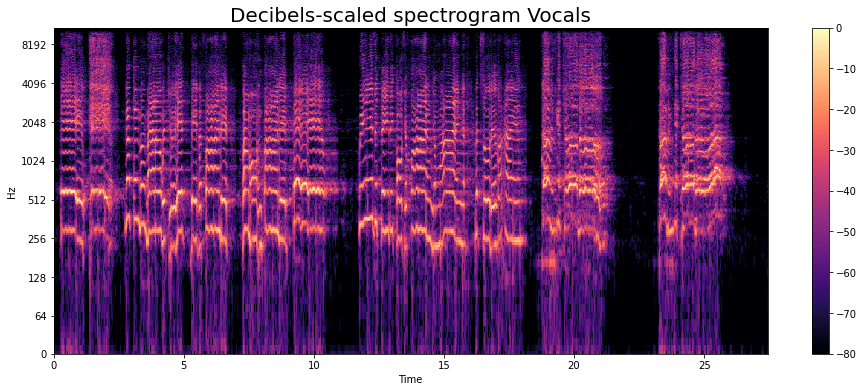

In [ ]:
y, sample_rate = librosa.load(sep_path + 'vocals.mp3')
D = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
print('Shape of D object:', np.shape(D))



DB = librosa.amplitude_to_db(D, ref = np.max)



plt.figure(figsize = (16, 6))
librosa.display.specshow(DB, sr=sample_rate, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title('Decibels-scaled spectrogram Vocals', fontsize=20)
plt.show()

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


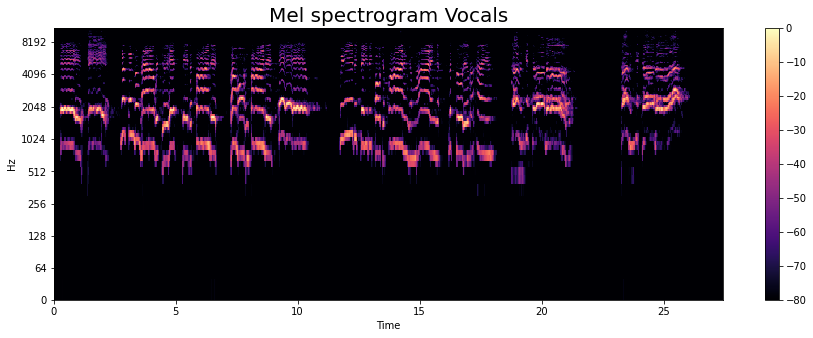

In [ ]:
y, sr = librosa.load(sep_path + 'vocals.mp3')

S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(15, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title("Mel spectrogram Vocals", fontsize=20)
plt.show()

### BASS SPECT

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Shape of D object: (1025, 1182)


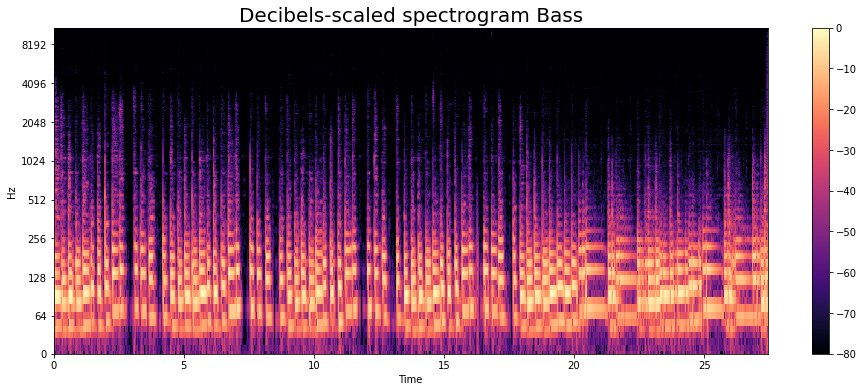

In [ ]:
y, sample_rate = librosa.load(sep_path + 'bass.mp3')
D = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
print('Shape of D object:', np.shape(D))



DB = librosa.amplitude_to_db(D, ref = np.max)



plt.figure(figsize = (16, 6))
librosa.display.specshow(DB, sr=sample_rate, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title('Decibels-scaled spectrogram Bass', fontsize=20)
plt.show()

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


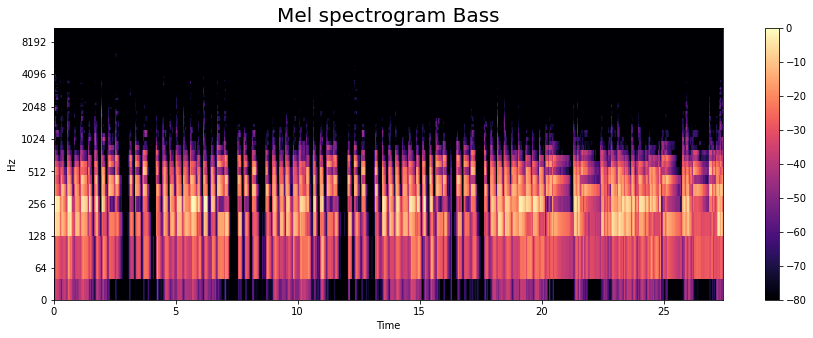

In [ ]:
y, sr = librosa.load(sep_path + 'bass.mp3')

S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(15, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title("Mel spectrogram Bass", fontsize=20)
plt.show()

### OTHER SPEC

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Shape of D object: (1025, 1182)


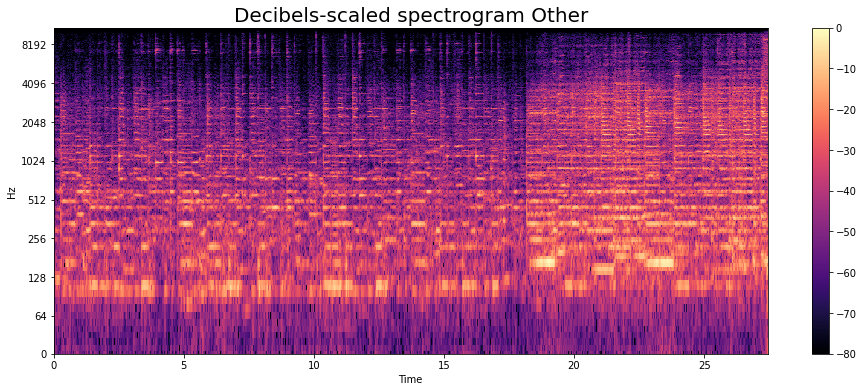

In [ ]:
y, sample_rate = librosa.load(sep_path + 'other.mp3')
D = np.abs(librosa.stft(y, n_fft=2048, hop_length=512))
print('Shape of D object:', np.shape(D))



DB = librosa.amplitude_to_db(D, ref = np.max)



plt.figure(figsize = (16, 6))
librosa.display.specshow(DB, sr=sample_rate, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title('Decibels-scaled spectrogram Other', fontsize=20)
plt.show()

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


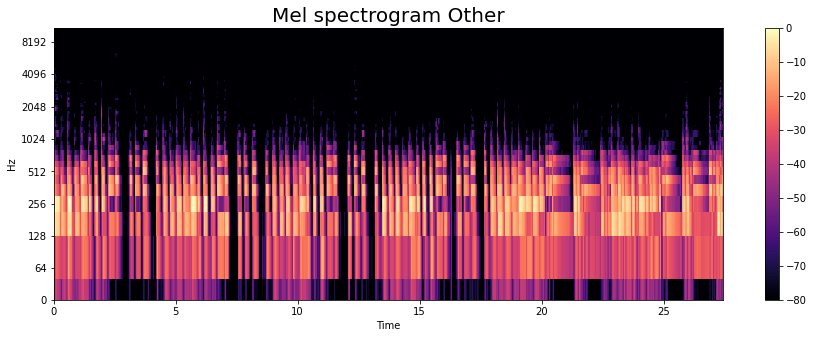

In [ ]:
y, sr = librosa.load(sep_path + 'bass.mp3')

S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)
plt.figure(figsize=(15, 5))
librosa.display.specshow(S_DB, sr=sr, hop_length=512,
                         x_axis='time', y_axis='log')
plt.colorbar()
plt.title("Mel spectrogram Other", fontsize=20)
plt.show()

### **Considerations of the spectograms.**

There are several advantages to having a good spectrogram as the output of the model.

A good spectrogram provides a clear and easy-to-interpret visual representation of a sound signal. This can be useful for identifying patterns and analyzing audio data.

They can be used to extract important features from audio signals, such as the presence of certain frequency ranges, the distribution of energy over time, and the shape of sound signals. These features can be used to train machine learning models or to perform other audio analysis tasks.

Spectrograms can also be used to evaluate the quality of audio signals. By comparing the spectrogram of an original signal with the spectrogram of a degraded signal, one can quantify the amount of degradation and evaluate the effectiveness of audio processing algorithms.


